### - 나이브 베이즈를 사용한 네이버 웹툰 장르 분류
#### 단일 문서의 WordColud
- NLTK(Natural Language Toolkit) : 자연어 처리 패키지
    - 말뭉치 : 자연어 분석 작업을 위해 만든 샘플 문서 집합
    - 토큰 생성 : 긴 문자열을 분석을 위한 작은 단위(토큰)로 나누는 작업
    - 토큰 생성 함수(tokenizer) : 문자열을 토큰으로 분리하는 함수
    - 형태소 분석(morhpeme) : 일정한 의미가 있는 가장 작은 말의 단위
        - 보통 자연어 처리에서 토큰으로 형태소를 이용
        - 어간 추출(stemming)
            - 변화된 잔어의 접미사나 어미를 제거하여 같은 의미를 가지는 형태소의 기본형을 찾는 방법
            - 단어의 원형의 정확성을 찾아주지는 않음
        - 원형 복원(lemmatizing)
            - 같은 의미를 가지는 여러 단어를 사전형으로 통일하는 작업
            - 품사(part of speech)를 지정하는 경우 좀 더 정확한 원형을 찾을 수 있음
        - 품사 부착(Part-Of-Speech tagging) : 설명(nltk.help.upenn_tagset)
            - NNP: 단수 고유명사
            - VB: 동사
            - VBP: 동사 현재형
            - TO: to 전치사
            - NN: 명사(단수형 혹은 집합형)
            - DT: 관형사
    - 품사 태깅
- 자연어의 의미를 분석하여 컴퓨터가 처리할 수 있도록 하는 일 

In [2]:
import pandas as pd

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_colwidth', -1)

# data 불러오기
df = pd.read_csv('naver_webtoon_info.csv')
df.replace('%', '').replace('.', '')\
    .replace(',', '').replace("'", '').replace('%', '')\
    .replace('?', '').replace("!", '')
df.tail()

,Unnamed: 0,title,genre,content,age
328,328,"그녀의 버킷리스트, 황양&솦","스토리, 드라마",미련없는 죽음을 위한그녀의 완벽한 버킷리스트,12세 이용가
329,329,"선녀야 야옹해봐!, 햄톨탱크","스토리, 로맨스",사랑 인연을 이어주기 위해 지상에 온 선녀 초미.톱스타 강수에게 냥줍을 당하다..!!,전체연령가
330,330,"갓!김치, 김민우","에피소드, 개그",​1000% 신토불이 히어로 등장!,전체연령가
331,331,"속삭이는 e로맨스, 최경아","스토리, 로맨스",불면증에 걸린 남자와 책만 읽으면 모두를 잠들게하는 여자가 만났다.,전체연령가
332,332,"호곡, 감대","스토리, 판타지",'이제 우리 차례야'조선의 왕 '천군'이 사라지고 3년 뒤...한 소녀가 나타나다.,12세 이용가


In [11]:
import pandas as pd

# csv file을 txt file로 변환하기
df = pd.read_csv('naver_webtoon_info.csv')
print(len(df))
df.to_csv('naver_webtoon_info.txt', 
          index=False, header=['no.', 'title', 'genre', 
                               'content', 'age'], sep="\t")
df = pd.read_csv('naver_webtoon_info.txt', delimiter = '\t')
print(len(df))
df.tail()

333
333


,no.,title,genre,content,age
328,328,"그녀의 버킷리스트, 황양&솦","스토리, 드라마",미련없는 죽음을 위한그녀의 완벽한 버킷리스트,12세 이용가
329,329,"선녀야 야옹해봐!, 햄톨탱크","스토리, 로맨스",사랑 인연을 이어주기 위해 지상에 온 선녀 초미.톱스타 강수에게 냥줍을 당하다..!!,전체연령가
330,330,"갓!김치, 김민우","에피소드, 개그",​1000% 신토불이 히어로 등장!,전체연령가
331,331,"속삭이는 e로맨스, 최경아","스토리, 로맨스",불면증에 걸린 남자와 책만 읽으면 모두를 잠들게하는 여자가 만났다.,전체연령가
332,332,"호곡, 감대","스토리, 판타지",'이제 우리 차례야'조선의 왕 '천군'이 사라지고 3년 뒤...한 소녀가 나타나다.,12세 이용가


In [12]:
# content 내부 특수문자 제거
df['content'] = df['content'].str.replace\
(pat=r'[%\.\,\?\!\♥\‘\’\'\~\(\)\…\"\<\>\/\+\※\r\n\-\[\]\']', 
 repl=r' ', regex=True)

In [13]:
# genre 내부 특수문자 제거
df['genre'] = df['genre'].str.replace(pat=r'[,]', repl=r'', regex=True)

In [37]:
# naver webtoon info 
import nltk 
from konlpy.corpus import kobill

files_ko = kobill.fileids()
doc_ko = open('naver_webtoon_info.txt').read()
# doc_ko

In [18]:
# 문서 전체에서 명사들만 추출
from konlpy.tag import Okt; t = Okt()

tokens_ko = t.nouns(doc_ko)
# tokens_ko

In [21]:
# 단어의 사용빈도 확인
ko = nltk.Text(tokens_ko, name='naver_webtoon_info')

print(len(ko.tokens))      # return number of tokens(document length)
print(len(set(ko.tokens))) # return number of unique tokens
ko.vocab()                 # return frequency disribution

6006
2236


FreqDist({'스토리': 283, '세': 195, '이용': 192, '전체': 145, '연령': 145, '드라마': 92, '로맨스': 89, '판타지': 71, '그': 55, '스릴러': 51, ...})

In [38]:
# matplotlib 한글 설정
import matplotlib.pyplot as plt
%matplotlib inline

from matplotlib import font_manager, rc
plt.rcParams['axes.unicode_minus'] = False

# f_path = '/Users/daesuncho/Library/Fonts/D2Coding-Ver1.3.2-20180524.ttf'
f_path = '/Library/Fonts/Arial Unicode.ttf'

font_name = font_manager.FontProperties(fname=f_path).get_name()
rc('font', family=font_name)

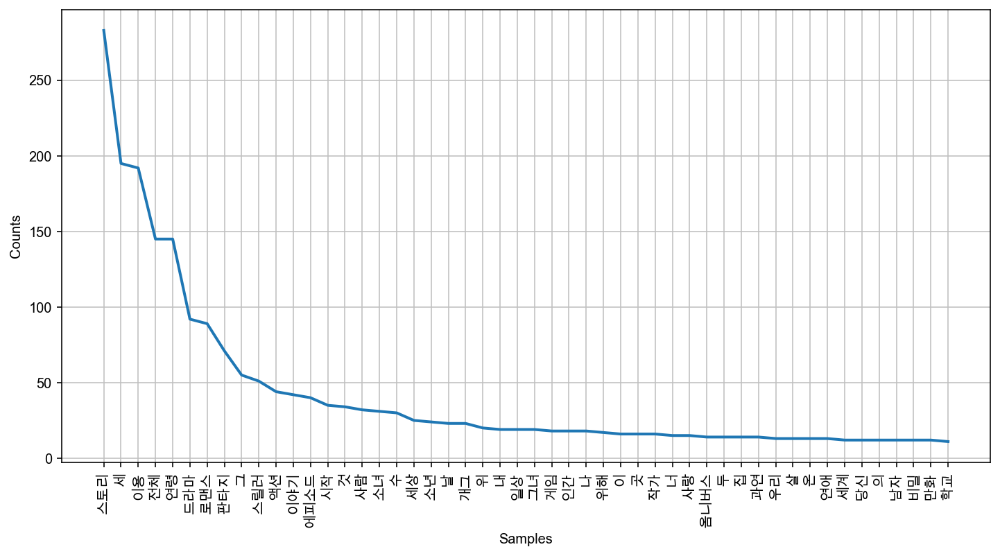

In [23]:
# 빈도별 정렬
plt.figure(figsize=(12,6))
ko.plot(50)
plt.show()

In [26]:
# stopword(불용어) 설정
stop_words = ['수', '것', '날', "위", '내', '나', '곳', '너', '두', '의',
              '자', '에', '안', '번', '호', '을', '이', '다', '만',
              '로', '가', '를', '세', '이용', '전체', '연령', '그',
              '집', '살', '온', '꿈', '스토리']
ko = [each_word for each_word in ko if each_word not in stop_words]
# ko

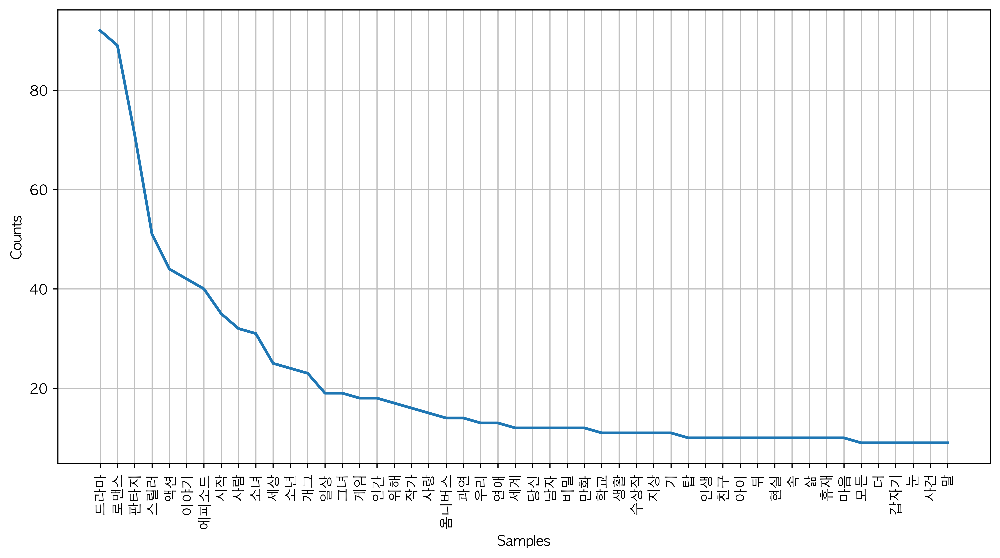

In [27]:
# 빈도 다시 그리기
# 웹툰 설명자료라서 장르에 대한 빈도가 높고, '시작', '사람', 소녀 등의 빈도수가 높음
ko = nltk.Text(ko, name='naver_webtoon_info')

plt.figure(figsize=(12,6))
ko.plot(50)    # Plot sorted frequency of top 50 tokens
plt.show()

In [31]:
# 특정 단어 발생 빈도
ko.count('드라마'), ko.count('판타지'), ko.count('스릴러'), ko.count('로맨스')

(92, 71, 51, 89)

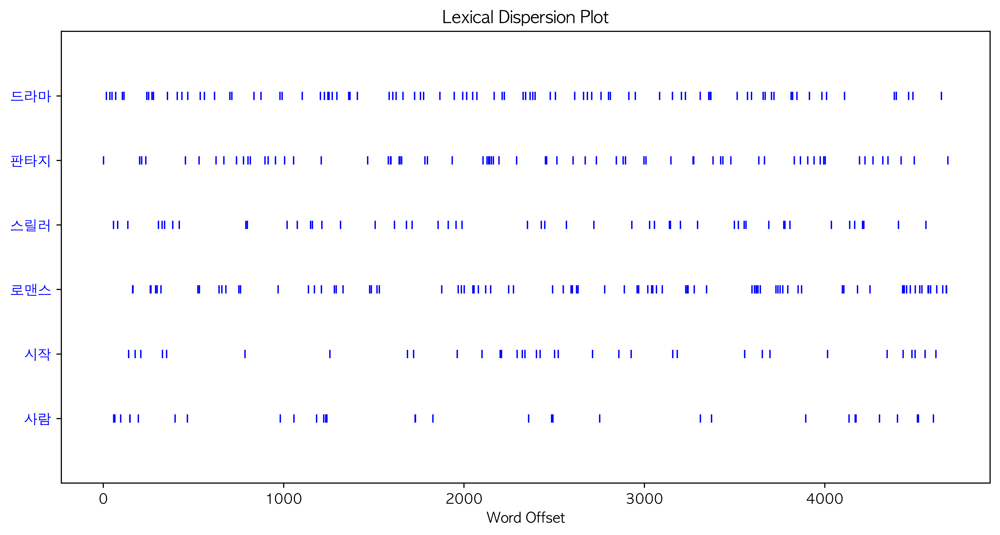

In [35]:
# 문서내의 특정 단어의 위치
plt.figure(figsize=(12,6))
ko.dispersion_plot(['드라마', '판타지', '스릴러', '로맨스', '시작', '사람'])

In [31]:
# 판타지란 특정 단어 주변에 나열된 단어
ko.concordance('판타지')

Displaying 25 of 71 matches:
신의 탑 스토리 판타지 자신 모든 것 소녀 탑 소년 소년 시험 탑 윈드브레이커 석 스토리 
 취준생 인성 아홉수 두 사람 힘 살인 범 앵무 살수 김성진 스토리 판타지 진시황 비서 선근 경 비서 살 수행 시작 히어로 메이커 옴니버스 판
지 진시황 비서 선근 경 비서 살 수행 시작 히어로 메이커 옴니버스 판타지 왕 영웅 공주 소원 전격 결심 공주 속 마치 영웅 것 만들기 위해 
온 나라 연극 눈물 영웅 만들기 대장정 링크 보이 광진 두엽 스토리 판타지 약육강식 무법 도시 도시 요리 스토리 드라마 요리 문외한 한별 요리
집값 내 마스크 걸 매미 작가 신작 요괴 대전 강두 장부 규 스토리 판타지 하루 아침 강시 소년 필립 난 더 이상 인간 결백 사람 서각 스토리
안 모락모락 왕세자 스토리 로맨스 마을 꽃미남 왕세자 일행 힘 소녀 판타지 로맨스 중독 연구소 김택기 옴니버스 드라마 중독 가정 자라 온 소년
 스토리 드라마 첫 술자리 전과 선언 거 내 얘기 백호 박혬 스토리 판타지 서쪽 신수 백호 과거 죄 위해 인간계 하늘 심부름 수행 뱀파이어 꽃
품 시리즈 리지 널 작품 네이버웹툰 듀얼 연재 블루투스 국승 스토리 판타지 탐사선 폭발 우주 한가운데 홀로 우주 비행사 여신 강림 야옹이 스토
 곳 못 생존 소년 지하 도시 비밀 사이드 킥 휴재 신의 철 스토리 판타지 슈퍼히어로 조수 사이드 킥 악당 빌런 슈퍼히어로 사이드 킥 이야기 
 스토리 액션 수명 대가 자의 능력 소년 신의 언어 장래 혁 스토리 판타지 퇴마 개념 영웅 프로그래머 난새 마 전투 시작 원주민 공포 만화 원
러 끝 말 것 당신 상상 본격 반전 공포 스릴러 하루 네 삼 스토리 판타지 인생 애가 전 반전 반전 거듭 궁 서스펜스 빙탕후루 장 주호민 에피
 애가 전 반전 반전 거듭 궁 서스펜스 빙탕후루 장 주호민 에피소드 판타지 신 주호민 작가 신작 환상 속 요괴 현세 중국 송나라 안도 연 귀 
상 외과 전문의 강혁 중증 외상 센터 프로젝트 에이 머 구동 스토리 판타

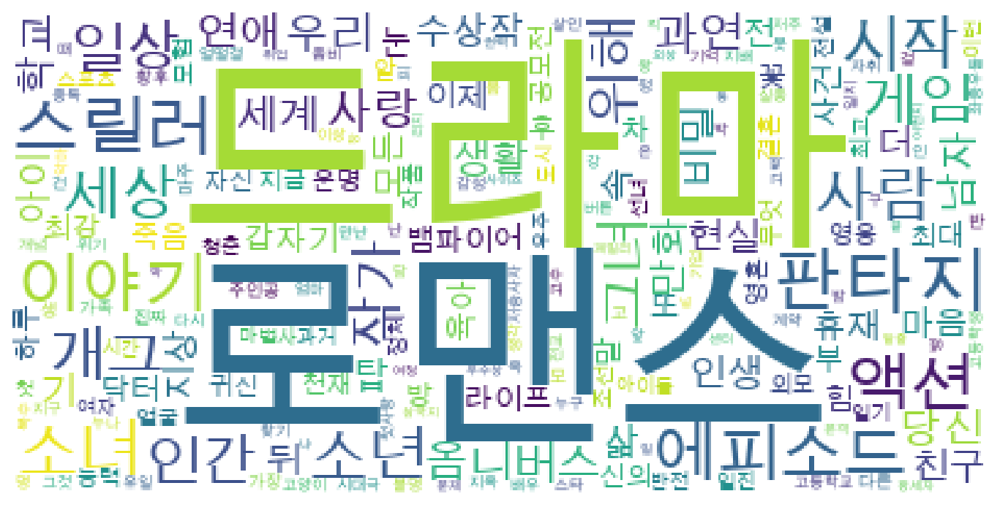

In [39]:
# wordcloud
from wordcloud import WordCloud

data = ko.vocab().most_common(200)

wordcloud = WordCloud(font_path=f_path, 
                     relative_scaling=0.2, 
                     background_color='white',
                     ).generate_from_frequencies(dict(data))
plt.figure(figsize=(12,8))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

### 한글에서 Naive Bayes Classifier
- KoNLPy(코엔엘파이) : 한국어 정보처리를 위한 파이썬 패키지
- 형태소 분석
    - 한나눔(Hannanum)
    - 꼬꼬마(Kkma)
    - 코모란(Komoran) : komoran은 빈줄이 있으면 에러가 남
    - 메카브(Mecab)
    - 오픈 소스 한국어 분석기(Open Korean Text)

- 결과 : 데이터 양이 작아서 그런지 대부분의 문장을 '드라마'로 분류

In [86]:
# konlpy 버전 확인
import warnings
warnings.simplefilter('ignore')

import konlpy
konlpy.__version__

'0.5.2'

In [61]:
# 훈련용 문장 한글
# from konlpy.tag import *

# hannanum = Hannanum()
# kkma = Kkma()
# komoran = Komoran()
# mecab = Mecab()
# okt = Okt()

from konlpy.tag import Okt
pos_tagger = Okt()

In [53]:
# 1. 장르가 '스토리, 드라마', '에피소드, 드라마' 형식이므로
# 2. genre에 '스토리' 제거한 컬럼으로 진행
genre = []
for g in df['genre']:
    genre.append(g.split()[1])
    
# print(genre)

In [55]:
# 새로운 장르 컬럼에 분리된 장르를 추가
df['genre1'] = genre
# df

In [59]:
# 3. 웹툰 소개내용에 특수기호 제거
# 4. ('웹툰 소개내용', '장르')를 train 데이터로 사용
train = list(zip(df['content'].str.replace\
                 (pat=r'[%\.\,\?\!\♥\‘\’\'\~\(\)\…\"\<\>\/\+\※\r\n\-\[\]\u200b\']', \
                  repl=r'', regex=True), df['genre1']))
# train

In [62]:
# 형태소 분석
# pos : 품사 부착
okt.pos(train[0][0])

[('자신', 'Noun'),
 ('의', 'Josa'),
 ('모든', 'Noun'),
 ('것', 'Noun'),
 ('이었던', 'Verb'),
 ('소녀', 'Noun'),
 ('를', 'Josa'),
 ('쫓아', 'Verb'),
 ('탑', 'Noun'),
 ('에', 'Josa'),
 ('들어온', 'Verb'),
 ('소년', 'Noun'),
 ('그리고', 'Conjunction'),
 ('그런', 'Adjective'),
 ('소년', 'Noun'),
 ('을', 'Josa'),
 ('시험', 'Noun'),
 ('하는', 'Verb'),
 ('탑', 'Noun')]

In [64]:
# 훈련용 데이터 형태소 분석
# morhps 명령 사용 : 모든 품사의 형태소를 알아내기
train_docs = [(pos_tagger.morphs(sentence[0]), sentence[1]) 
             for sentence in train]
# train_docs

In [65]:
# 말뭉치 만들기
# 데이터가 많을 경우, 사용하지 않는 것이 좋다고 함
all_words = set([t for d in train_docs for t in d[0]])
# all_words

{'보고',
 '쐬면',
 '개월',
 '뒷모습',
 '그',
 '하필',
 '난무',
 '넘치는',
 '커피',
 '잘리면',
 '조여오는',
 '게임',
 '눈',
 '슈퍼히어로',
 '방심하지',
 '연쇄',
 '웅이',
 '김정훈',
 '책임지지',
 '군사',
 '부적',
 '소녀더와일즈',
 '군생활',
 '전여친',
 '일기',
 '믿으시겠어요',
 '이',
 '후기',
 '듀얼',
 '만렙',
 '쓰다',
 '건의',
 '숨',
 '숲속',
 '경호원',
 '전화',
 '만들어진',
 '동양',
 '바뀐다면',
 '이란',
 '난세에',
 '변했다',
 '가지',
 '이다',
 '공유',
 '먹이',
 '주어진',
 '충격',
 '미쳤어',
 'SNS',
 '막아',
 '감정',
 '말리',
 '하는데',
 '수지',
 '하면서',
 '전격',
 '왔다',
 '바리',
 '12년',
 '숏애',
 '제임스',
 '쓰러져',
 '생존',
 '탐사선',
 '싸움',
 '몰려온다',
 '없도록',
 '실패한',
 '초낙운',
 '환생',
 '대로',
 '이지',
 '네',
 '나타나다',
 '부상',
 '래',
 '여대생',
 '뜻',
 '금붕어',
 '심하세요',
 '기괴한',
 '동갑',
 '살인자',
 '땅콩',
 '연루',
 '만난',
 '8',
 '그렇다면',
 '그리는',
 '날',
 '들어주기로',
 '44',
 '공부',
 '터프가이',
 '교복',
 '쫓기다',
 '갓',
 '복학생',
 '도구',
 '가수',
 '변호사',
 '지는',
 '신비한',
 '아동',
 '에게나',
 'RPG',
 '불안감',
 '했다',
 '전교',
 '아닌가요',
 '깨달',
 '일',
 '캐',
 '1일',
 '꼰대',
 '친해지게',
 '삼각관계',
 '있었다',
 '종교',
 '펼쳐집니다',
 '험한',
 '윤하',
 '였던',
 '조각',
 '다른',
 '땅',
 '살려줘',
 '뽀짝',
 '이오',
 '될',
 '에서의',
 '좌충우돌',
 '

In [66]:
# 있는지 없는지 확인
def term_exists(doc):
    return {word: (word in set(doc)) for word in all_words}

In [67]:
%%time
train_xy = [(term_exists(d), c) for d,c in train_docs]
# train_xy

CPU times: user 411 ms, sys: 8.84 ms, total: 420 ms
Wall time: 420 ms


[({'보고': False,
   '쐬면': False,
   '개월': False,
   '뒷모습': False,
   '그': False,
   '하필': False,
   '난무': False,
   '넘치는': False,
   '커피': False,
   '잘리면': False,
   '조여오는': False,
   '게임': False,
   '눈': False,
   '슈퍼히어로': False,
   '방심하지': False,
   '연쇄': False,
   '웅이': False,
   '김정훈': False,
   '책임지지': False,
   '군사': False,
   '부적': False,
   '소녀더와일즈': False,
   '군생활': False,
   '전여친': False,
   '일기': False,
   '믿으시겠어요': False,
   '이': False,
   '후기': False,
   '듀얼': False,
   '만렙': False,
   '쓰다': False,
   '건의': False,
   '숨': False,
   '숲속': False,
   '경호원': False,
   '전화': False,
   '만들어진': False,
   '동양': False,
   '바뀐다면': False,
   '이란': False,
   '난세에': False,
   '변했다': False,
   '가지': False,
   '이다': False,
   '공유': False,
   '먹이': False,
   '주어진': False,
   '충격': False,
   '미쳤어': False,
   'SNS': False,
   '막아': False,
   '감정': False,
   '말리': False,
   '하는데': False,
   '수지': False,
   '하면서': False,
   '전격': False,
   '왔다': False,
   '바리': False,
   '12년': False,
   '숏애':

In [72]:
# 나이브 베이즈(Naive Bayes) 훈련
classifier = nltk.NaiveBayesClassifier.train(train_xy)
classifier.show_most_informative_features()

Most Informative Features
                      성장 = True               감성 : 드라마    =     22.5 : 1.0
                      피해 = True               감성 : 드라마    =     22.5 : 1.0
                      순간 = True               감성 : 드라마    =     22.5 : 1.0
                       너 = True               감성 : 드라마    =     22.5 : 1.0
                      용기 = True               감성 : 드라마    =     22.5 : 1.0
                       게 = True               감성 : 드라마    =     22.5 : 1.0
                       줄 = True               감성 : 드라마    =     22.5 : 1.0
                      부터 = True               감성 : 드라마    =     22.5 : 1.0
                      되어 = True               감성 : 드라마    =     22.5 : 1.0
                     드라마 = True              스포츠 : 드라마    =     21.4 : 1.0


In [73]:
# 테스트 문장
# test_sentence = '함께 할 때 행복을 주는 사람' # 드라마
test_sentence = '어느 날 생긴 예측불가의 초능력'
test_docs = pos_tagger.morphs(test_sentence)
test_docs

['어느', '날', '생긴', '예측', '불가', '의', '초능력']

In [74]:
# 테스트 문장 대입
test_xy = term_exists(test_docs)
test_xy

{'보고': False,
 '쐬면': False,
 '개월': False,
 '뒷모습': False,
 '그': False,
 '하필': False,
 '난무': False,
 '넘치는': False,
 '커피': False,
 '잘리면': False,
 '조여오는': False,
 '게임': False,
 '눈': False,
 '슈퍼히어로': False,
 '방심하지': False,
 '연쇄': False,
 '웅이': False,
 '김정훈': False,
 '책임지지': False,
 '군사': False,
 '부적': False,
 '소녀더와일즈': False,
 '군생활': False,
 '전여친': False,
 '일기': False,
 '믿으시겠어요': False,
 '이': False,
 '후기': False,
 '듀얼': False,
 '만렙': False,
 '쓰다': False,
 '건의': False,
 '숨': False,
 '숲속': False,
 '경호원': False,
 '전화': False,
 '만들어진': False,
 '동양': False,
 '바뀐다면': False,
 '이란': False,
 '난세에': False,
 '변했다': False,
 '가지': False,
 '이다': False,
 '공유': False,
 '먹이': False,
 '주어진': False,
 '충격': False,
 '미쳤어': False,
 'SNS': False,
 '막아': False,
 '감정': False,
 '말리': False,
 '하는데': False,
 '수지': False,
 '하면서': False,
 '전격': False,
 '왔다': False,
 '바리': False,
 '12년': False,
 '숏애': False,
 '제임스': False,
 '쓰러져': False,
 '생존': False,
 '탐사선': False,
 '싸움': False,
 '몰려온다': False,
 '없도록': False,
 '실패한': Fa

In [75]:
# 테스트 문장을 드라마로 분류
classifier.classify(test_xy)

'드라마'

In [76]:
test_sentence = '희망 없는 청춘에게 쓸모 없는 힘이 생겼다'
classifier.classify(term_exists(pos_tagger.morphs(test_sentence)))

'드라마'

In [78]:
test_sentence = '묘약으로 시작된 기간한정 연애, 두 형제를 사로 잡아버린 마녀의 후예'
classifier.classify(term_exists(pos_tagger.morphs(test_sentence)))

'드라마'

In [79]:
test_sentence = '정상회담을 위해 한자리에 모인 남북미 3인의 정상들. 예상치 못한 위기에 빠진다.'
classifier.classify(term_exists(pos_tagger.morphs(test_sentence)))

'드라마'

In [80]:
test_sentence = '너무 다른 두 사람의 연애 3년, 민성의 비밀은 두 사람을 예기치 못 한 사건에 휘말리게 한다'
classifier.classify(term_exists(pos_tagger.morphs(test_sentence)))

'드라마'

In [81]:
test_sentence = '내가 가르치는 보컬수업에, 우리 과 교수님이 수강생으로 들어왔다'
classifier.classify(term_exists(pos_tagger.morphs(test_sentence)))

'드라마'

In [82]:
test_sentence = '사돈 사이가 된 원수지간 남녀. 때마침 모든 걸 되돌릴 수 있는 기회가 눈앞에 찾아오는데'
classifier.classify(term_exists(pos_tagger.morphs(test_sentence)))

'드라마'

In [83]:
test_sentence = '학교가 싫은 아싸 두봉과 학교가 너무 좋은 인싸 윤정의 이야기'
classifier.classify(term_exists(pos_tagger.morphs(test_sentence)))

'드라마'

In [85]:
test_sentence = '압도적이고 거대한 그들의 힘과 부딪히는 특별한 한 명'
classifier.classify(term_exists(pos_tagger.morphs(test_sentence)))

'드라마'

### 연습용 Naive Bayes Classifier

In [45]:
# tokenize : 문장을 구성하는 의미있는 단어로 나누는 작업
from nltk.tokenize import word_tokenize
import nltk

In [40]:
import pandas as pd
df = pd.read_csv('naver_webtoon_info.txt', delimiter='\t')
df.tail()

,no.,title,genre,content,age
328,328,"그녀의 버킷리스트, 황양&솦","스토리, 드라마",미련없는 죽음을 위한그녀의 완벽한 버킷리스트,12세 이용가
329,329,"선녀야 야옹해봐!, 햄톨탱크","스토리, 로맨스",사랑 인연을 이어주기 위해 지상에 온 선녀 초미.톱스타 강수에게 냥줍을 당하다..!!,전체연령가
330,330,"갓!김치, 김민우","에피소드, 개그",​1000% 신토불이 히어로 등장!,전체연령가
331,331,"속삭이는 e로맨스, 최경아","스토리, 로맨스",불면증에 걸린 남자와 책만 읽으면 모두를 잠들게하는 여자가 만났다.,전체연령가
332,332,"호곡, 감대","스토리, 판타지",'이제 우리 차례야'조선의 왕 '천군'이 사라지고 3년 뒤...한 소녀가 나타나다.,12세 이용가


In [42]:
# 1. 훈련용 마킹에 특수기호 제거하기
train = list(zip(df['content'].str.replace(pat=r'[%\.\,\?\!\♥\‘\’\'\~\(\)\…\"\<\>\/\+\※\r\n\-\[\]\u200b\']',
                                           repl=r'', regex=True), df['genre'].str.replace(pat=r'[,]', repl=r'', regex=True)))
# train

In [47]:
# 전체 말뭉치
all_words = []
for sentence in train:
    for word in word_tokenize(sentence[0]):
        all_words.append(word)
        
print(len(set(all_words)))
# set(all_words)

2948


In [48]:
%%time
# 훈련용 데이터에 마킹
t = [({word: (word in word_tokenize(x[0])) 
       for word in all_words}, x[1])
    for x in train]

# t

CPU times: user 1min 42s, sys: 155 ms, total: 1min 42s
Wall time: 1min 42s


In [174]:
%%time
# 나이브 베이지안 분류(Naive Bayes Classifier)
# '못한'이 있는 것은 43.3:1.0의 확률로 '에피소드' 이다.
# '없는'이 있는 것은 39.0:1.0의 확률로 '옴니버스' 이다. 
classifier = nltk.NaiveBayesClassifier.train(t)
classifier.show_most_informative_features()

Most Informative Features
                      못한 = True           에피소드 시 : 스토리 드라 =     43.3 : 1.0
                     작가의 = True           에피소드 판 : 스토리 드라 =     39.0 : 1.0
                      없는 = True           옴니버스 일 : 스토리 드라 =     39.0 : 1.0
                      신작 = True           에피소드 판 : 스토리 드라 =     39.0 : 1.0
                       것 = True           옴니버스 액 : 스토리 드라 =     39.0 : 1.0
                       등 = True           에피소드 시 : 스토리 판타 =     30.0 : 1.0
                     새로운 = True           에피소드 시 : 스토리 판타 =     30.0 : 1.0
                      함께 = True           에피소드 판 : 스토리 로맨 =     28.5 : 1.0
                       날 = True           옴니버스 일 : 스토리 판타 =     27.0 : 1.0
                      하고 = True           에피소드 로 : 스토리 드라 =     26.0 : 1.0
CPU times: user 1.3 s, sys: 76.7 ms, total: 1.38 s
Wall time: 1.4 s


In [185]:
# test 문장 입력
test_sentence = '새로운 날 함께 하고 싶은 사람'
test_sent_features = {word.lower(): (word in word_tokenize(test_sentence.lower()))
                     for word in all_words}
test_sent_features

{'자신의': False,
 '모든': False,
 '것이었던': False,
 '소녀를': False,
 '쫓아': False,
 '탑에': False,
 '들어온': False,
 '소년그리고': False,
 '그런': False,
 '소년을': False,
 '시험하는': False,
 '탑': False,
 '자유를': False,
 '꿈꾸는': False,
 '청춘들의': False,
 '스트릿라이딩': False,
 '드라마': False,
 '학교': False,
 '다닐때': False,
 '그렇게': False,
 '놀았으면': False,
 '졸업하고': False,
 '지금은': False,
 '불행해야하는거': False,
 '아니야너': False,
 '때문에': False,
 '망한': False,
 '내인생': False,
 '너도': False,
 '한번': False,
 '당해봐': False,
 '완벽해': False,
 '보이지만': False,
 '사실': False,
 '외로웠던': False,
 '백조들과': False,
 '맘씨': False,
 '착한': False,
 '오리가': False,
 '만나여러': False,
 '갈등을': False,
 '함께': True,
 '겪으며': False,
 '진짜': False,
 '친구가': False,
 '되어가는데': False,
 '안': False,
 '평범한': False,
 '아이들이': False,
 '모인': False,
 '8반고품격': False,
 '웰메이드': False,
 '병맛을': False,
 '느껴보세요': False,
 '사람들은': False,
 '모여': False,
 '무서운': False,
 '이야기라며': False,
 '귀신이야기를': False,
 '한다귀신들은': False,
 '귀신보다': False,
 '더': False,
 '무섭고': False,
 '섬뜩한': False,
 '사람들의': False,
 '이야기를': 

In [186]:
# 분류 결과
classifier.classify(test_sent_features)

'스토리 드라마'

In [249]:
# 2. genre에 '스토리' 제거한 컬럼으로 진행
genre = []
for g in df['genre']:
    genre.append(g.split()[1])
    
print(genre)

['판타지', '스포츠', '액션', '드라마', '드라마', '스릴러', '드라마', '스릴러', '시대극', '드라마', '드라마', '스릴러', '액션', '로맨스', '개그', '판타지', '판타지', '판타지', '드라마', '드라마', '로맨스', '드라마', '드라마', '로맨스', '로맨스', '스릴러', '로맨스', '스릴러', '스릴러', '드라마', '일상', '스릴러', '드라마', '스릴러', '드라마', '판타지', '드라마', '액션', '액션', '액션', '로맨스', '드라마', '드라마', '일상', '액션', '드라마', '판타지', '로맨스', '판타지', '로맨스', '개그', '드라마', '드라마', '액션', '판타지', '로맨스', '액션', '판타지', '스릴러', '판타지', '판타지', '드라마', '일상', '드라마', '판타지', '판타지', '시대극', '판타지', '로맨스', '드라마', '드라마', '판타지', '스릴러', '액션', '개그', '판타지', '스릴러', '액션', '드라마', '일상', '로맨스', '스릴러', '스릴러', '개그', '액션', '드라마', '스릴러', '감성', '드라마', '드라마', '드라마', '개그', '드라마', '로맨스', '드라마', '스릴러', '로맨스', '액션', '드라마', '드라마', '액션', '드라마', '스포츠', '판타지', '로맨스', '액션', '스릴러', '로맨스', '개그', '개그', '액션', '드라마', '판타지', '드라마', '스릴러', '드라마', '판타지', '드라마', '액션', '스릴러', '액션', '스릴러', '드라마', '시대극', '개그', '드라마', '드라마', '판타지', '판타지', '일상', '일상', '스릴러', '드라마', '로맨스', '개그', '스릴러', '판타지', '드라마', '스릴러', '로맨스', '로맨스', '드라마', '로맨스', '드라마', '일상', '드라마', '액션', '드라마'

In [251]:
df['genre1'] = genre
df

,no.,title,genre,content,age,genre1
0,0,"신의 탑, SIU","스토리, 판타지",자신의 모든 것이었던 소녀를 쫓아 탑에 들어온 소년그리고 그런 소년을 시험하는 탑,12세 이용가,판타지
1,1,"윈드브레이커, 조용석","스토리, 스포츠",자유를 꿈꾸는 청춘들의 스트릿라이딩 드라마,12세 이용가,스포츠
2,2,"인생존망, 박태준&전선욱","에피소드, 액션","학교 다닐때 그렇게 놀았으면, 졸업하고 지금은 불행해야하는거 아니야?너 때문에 망한 내인생, 너도 한번 당해봐",15세 이용가,액션
3,3,"소녀의 세계, 모랑지","스토리, 드라마",완벽해 보이지만 사실 외로웠던 백조들과 맘씨 착한 오리가 만나여러 갈등을 함께 겪으며 진짜 친구가 되어가는데...,전체연령가,드라마
4,4,"평범한 8반, 영파카","스토리, 드라마",안 평범한 아이들이 모인 평범한 8반고품격 웰메이드 병맛을 느껴보세요,15세 이용가,드라마
5,5,"귀전구담, QTT","옴니버스, 스릴러",사람들은 모여 무서운 이야기라며 귀신이야기를 한다.귀신들은 모여 귀신보다 더 무섭고 섬뜩한 사람들의 이야기를 한다.,12세 이용가,스릴러
6,6,"백수세끼, 치즈","스토리, 드라마",이별 뒤에도 밥은 넘어간다.백수 재호가 먹는 세끼,전체연령가,드라마
7,7,"야자괴담, 이도광","옴니버스, 스릴러","어느 날 듣게 된 우리 학교의 야자 괴담. 그날 밤, 괴담이 현실이 되어 나를 찾아왔다.",12세 이용가,스릴러
8,8,"장씨세가 호위무사, 조형근&김인호","스토리, 시대극",‘당신이 부른 것이오. 나란 사람을... ’은둔고수 광휘. 호위무사 되다!,12세 이용가,시대극
9,9,"니편내편, 미티","스토리, 드라마",외로운 인생사진만 찍으면 누구든 내 편이 된다?!,12세 이용가,드라마


In [274]:
train = list(zip(df['content'].str.replace(pat=r'[%\.\,\?\!\♥\‘\’\'\~\(\)\…\"\<\>\/\+\※\r\n\-\[\]\u200b\']', repl=r'', regex=True), df['genre1']))
train

[('자신의 모든 것이었던 소녀를 쫓아 탑에 들어온 소년그리고 그런 소년을 시험하는 탑', '판타지'),
 ('자유를 꿈꾸는 청춘들의 스트릿라이딩 드라마', '스포츠'),
 ('학교 다닐때 그렇게 놀았으면 졸업하고 지금은 불행해야하는거 아니야너 때문에 망한 내인생 너도 한번 당해봐', '액션'),
 ('완벽해 보이지만 사실 외로웠던 백조들과 맘씨 착한 오리가 만나여러 갈등을 함께 겪으며 진짜 친구가 되어가는데', '드라마'),
 ('안 평범한 아이들이 모인 평범한 8반고품격 웰메이드 병맛을 느껴보세요', '드라마'),
 ('사람들은 모여 무서운 이야기라며 귀신이야기를 한다귀신들은 모여 귀신보다 더 무섭고 섬뜩한 사람들의 이야기를 한다', '스릴러'),
 ('이별 뒤에도 밥은 넘어간다백수 재호가 먹는 세끼', '드라마'),
 ('어느 날 듣게 된 우리 학교의 야자 괴담 그날 밤 괴담이 현실이 되어 나를 찾아왔다', '스릴러'),
 ('당신이 부른 것이오 나란 사람을 은둔고수 광휘 호위무사 되다', '시대극'),
 ('외로운 인생사진만 찍으면 누구든 내 편이 된다', '드라마'),
 ('치사율 100의 인싸 희귀병 소녀 사랑누구보다 차분하고 두려움 없는 같은 반 소녀 은조두 소녀가 가슴 속 칼을 품고 세상을 향한 복수를 꿈꾼다',
  '드라마'),
 ('며칠 전부터 아랫집에서 썩은 내가 나기 시작했다 냄새가 나고 얼마 뒤 친구가 사라졌다 그리고 아랫집 누나까지 그 다음은 사라진 사람들 그리고 그들을 찾는 사람들의 이야기',
  '스릴러'),
 ('지능을 가진 좀비세상을 파멸시킬 것인가 구원할 것인가', '액션'),
 ('평범한 취준생 공유일의 일상에인기절정 탑배우 탁무이와 아이돌 류민이 침범해오기 시작했다 사심가득 탑스타', '로맨스'),
 ('얼떨결에 죽어 스마트폰이 된 39살 대기업 천재 CEO 선주얼떨결에 그 스마트폰을 주운 29살 취준생 인성아홉수 두 사람이 힘을 합쳐 살인범을 찾는다',
  '개그'),
 ('진시황이 남긴 비서 선근경비서를 둘러싼 살수행이

In [255]:
# 전체 말뭉치
all_words = []
for sentence in train:
    for word in word_tokenize(sentence[0]):
        all_words.append(word)
        
all_words.remove('스토리')     
print(len(set(all_words)))
set(all_words)

2948


{'열린다허구',
 '신묘한',
 '은하학원',
 '궁금하다',
 '되어버릴',
 '찾아온',
 '짝사랑남',
 '울고',
 '큰',
 '솔직',
 '청춘들의',
 '황후가',
 '손세인',
 '음모와',
 '판타지세계',
 '호랑이',
 '상남자가',
 '유일한',
 '배달을',
 '남학생의',
 '꿈꾸었던',
 '걸리게',
 '들어온다',
 '찾아와',
 '3세가',
 '아이를',
 '믿는',
 '막히는',
 '몸종으로',
 '소녀',
 '취업이',
 '아버지',
 '꽃미남',
 '완수하고',
 '과거를',
 '퇴마가',
 '안되는',
 '함께하는20살',
 '이유',
 '격투기',
 '사고만',
 '조선혼인금지령왕을',
 '괴물생존을',
 '만화',
 '미지의',
 '한선녀우연히',
 '맞춰라방송부',
 '뒤',
 '100까지의',
 '대로',
 '집을',
 '천리사더이상',
 '망한',
 '자와',
 '리얼리티',
 '빨간',
 '못했는데',
 '가기',
 '자들빨간',
 '최준웅27세남우연한',
 '세상으로부터의',
 '포기했지만',
 '네가이제는',
 '그애에겐',
 '가고',
 '오지오',
 '사랑하게',
 '사라지고',
 '여신에게는',
 '시간과',
 '바다로',
 '기사와',
 '지날수록',
 '한태성을',
 '꼬인',
 '말입니다',
 '스타가',
 '거대기업을',
 '미쳤어',
 '성공꽃길만',
 '현혹된',
 '의문의',
 '타겟이',
 '남극전자',
 '세계',
 '지망생불의의',
 '17년',
 '느껴보세요',
 '푸른',
 '아빠의',
 '찍으면',
 '한별요리고등학교',
 '백승혁을',
 '무엇이며',
 '그들의',
 '죽어야',
 '살고있다',
 '수영',
 '고생',
 '장난일까',
 '그렇게',
 '선물일까',
 '호랭총각과',
 '남은',
 '조득만우연히',
 '치사율',
 '하트',
 '이성인',
 '일상',
 '인간인간을',
 '기이한',
 '잔인하고',
 '영웅들이',
 '어쩐지',
 '검도장에서',
 '되어있나요',

In [256]:
%%time
# 훈련용 데이터에 마킹
t = [({word: (word in word_tokenize(x[0])) 
       for word in all_words}, x[1])
    for x in train]

t

CPU times: user 1min 45s, sys: 180 ms, total: 1min 45s
Wall time: 1min 45s


[({'자신의': True,
   '모든': True,
   '것이었던': True,
   '소녀를': True,
   '쫓아': True,
   '탑에': True,
   '들어온': True,
   '소년그리고': True,
   '그런': True,
   '소년을': True,
   '시험하는': True,
   '탑': True,
   '자유를': False,
   '꿈꾸는': False,
   '청춘들의': False,
   '스트릿라이딩': False,
   '드라마': False,
   '학교': False,
   '다닐때': False,
   '그렇게': False,
   '놀았으면': False,
   '졸업하고': False,
   '지금은': False,
   '불행해야하는거': False,
   '아니야너': False,
   '때문에': False,
   '망한': False,
   '내인생': False,
   '너도': False,
   '한번': False,
   '당해봐': False,
   '완벽해': False,
   '보이지만': False,
   '사실': False,
   '외로웠던': False,
   '백조들과': False,
   '맘씨': False,
   '착한': False,
   '오리가': False,
   '만나여러': False,
   '갈등을': False,
   '함께': False,
   '겪으며': False,
   '진짜': False,
   '친구가': False,
   '되어가는데': False,
   '안': False,
   '평범한': False,
   '아이들이': False,
   '모인': False,
   '8반고품격': False,
   '웰메이드': False,
   '병맛을': False,
   '느껴보세요': False,
   '사람들은': False,
   '모여': False,
   '무서운': False,
   '이야기라며': False,
   '귀신이야기를': Fa

In [257]:
%%time
# 나이브 베이지안 분류(Naive Bayes Classifier)
# '못한'이 있는 것은 25.0:1.0의 확률로 '시대극' 이다.
# '용기'라는 단어가 있는 것은 22.5:1.0의 확률로 '감성' 이다. 
classifier = nltk.NaiveBayesClassifier.train(t)
classifier.show_most_informative_features()

Most Informative Features
                      못한 = True              시대극 : 드라마    =     25.0 : 1.0
                      되어 = True               감성 : 드라마    =     22.5 : 1.0
                     용기를 = True               감성 : 드라마    =     22.5 : 1.0
                     너에게 = True               감성 : 드라마    =     22.5 : 1.0
                       등 = True              시대극 : 판타지    =     15.8 : 1.0
                     새로운 = True              시대극 : 판타지    =     15.8 : 1.0
                     소녀의 = True               감성 : 로맨스    =     15.2 : 1.0
                      어느 = True               감성 : 로맨스    =     15.2 : 1.0
                    순간부터 = True               감성 : 로맨스    =     15.2 : 1.0
                      나의 = True               감성 : 로맨스    =     15.2 : 1.0
CPU times: user 1.28 s, sys: 323 ms, total: 1.6 s
Wall time: 1.77 s


In [296]:
# test 문장 입력
# test_sentence = '함께 할 때 행복을 주는 사람' # 드라마
test_sentence = '우리 채널에 범죄자가 접속했다숨막히는 생방송 스릴러'
test_sent_features = {word.lower(): (word in word_tokenize(test_sentence.lower()))
                     for word in all_words}
test_sent_features

{'신묘한': False,
 '궁금하다': False,
 '찾아온': False,
 '큰': False,
 '솔직': False,
 '리지': False,
 '위': False,
 '호랑이': False,
 '유일한': False,
 '꿈꾸었던': False,
 '걸리게': False,
 '했잖아': False,
 '들어온다': False,
 '찾아와': False,
 '동안': False,
 '믿는': False,
 '막히는': False,
 '비관': False,
 '소녀': False,
 '아버지': False,
 '꽃미남': False,
 '안되는': False,
 '이유': False,
 '격투기': False,
 '만화': False,
 '중심': False,
 '물리': False,
 '둘': False,
 '한두': False,
 '예측': False,
 '뒤': False,
 '대로': False,
 '일행': False,
 '보이': False,
 '큐피드': False,
 '믿으시겠어요': False,
 '망한': False,
 '짱': False,
 '일까': False,
 '리얼리티': False,
 '친다랑': False,
 '빨간': False,
 '가기': False,
 '하려고': False,
 '고민': False,
 '위협': False,
 '담당자': False,
 '타인': False,
 '도사': False,
 '가고': False,
 '하르모니아': False,
 '시즌': False,
 '사라지고': False,
 '바다로': False,
 '권': False,
 '지날수록': False,
 '꼬인': False,
 '미쳤어': False,
 '불면증': False,
 '보': False,
 '장난': False,
 '불허': False,
 '세계': False,
 '17년': False,
 '은둔': False,
 '숨기': False,
 '푸른': False,
 '찍으면': False,
 '수재': False,
 

In [297]:
# 분류 결과
classifier.classify(test_sent_features)

'드라마'